In [1]:
import cv2,glob, math
import numpy as np
import matplotlib.pyplot as plt
import os
import albumentations as A
from tqdm import tqdm
import pandas as pd
import shutil

/home/duc/Documents/DoAn/myvenv/lib/python3.10/site-packages/albumentations/check_version.py:147: UserWarning: Error fetching version info <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: self-signed certificate (_ssl.c:1007)>
  data = fetch_version_info()


In [10]:

# ================== CẤU HÌNH ==================
# Thư mục gốc chứa TẤT CẢ ảnh (không còn thư mục con theo lớp)
ROOT_DIR = "eyepascs_2015/train/4"     # ví dụ: "eyepascs_2015/train_all"
EXT = ".jpg"                             # có thể đổi: ".png", ".jpeg", ...
PER_LABEL_SHOW = 100                     # số ảnh mỗi nhãn chất lượng để hiển thị
SAVE_PREVIEW_DIR = None                  # ví dụ "preview_quality"; None = không lưu
OUTPUT_CSV = "image_quality_labels.csv"  # CSV đầu ra

# Ngưỡng phân loại (bạn có thể chỉnh sau khi xem kết quả)
REJECT_RULES = {
    "min_lap_var": 80.0,        # mờ nặng nếu < 80
    "min_tenengrad": 120.0,     # mờ nặng nếu < 120
    "min_contrast": 22.0,       # tương phản quá thấp 22 
    "min_brightness": 35.0,     # quá tối 35.0
    "max_brightness": 220.0,    # quá sáng
    "max_dark_frac": 0.40,      # phần trăm điểm rất tối quá cao 40
    "max_white_frac": 0.25,     # phần trăm điểm rất sáng quá cao
    "min_foreground_ratio": 0.45, # viền đen nhiều/quá ít tín hiệu
}

GOOD_RULES = {
    "min_lap_var": 180.0,
    "min_tenengrad": 250.0,
    "min_contrast": 32.0,
    "min_brightness": 60.0,
    "max_brightness": 190.0,
    "max_dark_frac": 0.35,
    "max_white_frac": 0.12,
    "min_foreground_ratio": 0.65,
}

MAX_SIDE_FOR_METRIC = 1024  # tính metric trên ảnh không quá lớn để ổn định
# ==============================================

def imread_rgb(path):
    img = cv2.imread(path, cv2.IMREAD_COLOR)
    if img is None: return None
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def resize_for_metric(img, max_side=MAX_SIDE_FOR_METRIC):
    h, w = img.shape[:2]
    m = max(h, w)
    if m <= max_side:
        return img
    s = max_side / float(m)
    nh, nw = int(round(h*s)), int(round(w*s))
    return cv2.resize(img, (nw, nh), interpolation=cv2.INTER_AREA)

def compute_quality_metrics(path):
    img = imread_rgb(path)
    if img is None:
        return None
    rimg = resize_for_metric(img)
    gray8 = cv2.cvtColor(rimg, cv2.COLOR_RGB2GRAY)
    if gray8.dtype != np.uint8:
        gray8 = cv2.normalize(gray8, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Độ nét
    lap = cv2.Laplacian(gray8, cv2.CV_64F, ksize=3)
    lap_var = float(lap.var())
    gx = cv2.Sobel(gray8, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray8, cv2.CV_32F, 0, 1, ksize=3)
    tenengrad = float(np.mean(gx*gx + gy*gy))

    # Sáng / tương phản
    gray32 = gray8.astype(np.float32)
    brightness = float(gray32.mean())
    contrast   = float(gray32.std())

    # Tối/quá sáng
    dark_frac  = float((gray8 < 15).mean())
    white_frac = float((gray8 > 240).mean())

    # Foreground (viền đen)
    fg_ratio   = float((gray8 > 10).mean())

    return {
        "lap_var": lap_var,
        "tenengrad": tenengrad,
        "brightness": brightness,
        "contrast": contrast,
        "dark_frac": dark_frac,
        "white_frac": white_frac,
        "foreground_ratio": fg_ratio,
        "height": rimg.shape[0],
        "width": rimg.shape[1],
    }

def rate_quality(m, reject_rules=REJECT_RULES, good_rules=GOOD_RULES):
    # 1) Reject nếu vi phạm NGHIÊM TRỌNG bất kỳ tiêu chí nào
    if (m is None or
        m["lap_var"] < reject_rules["min_lap_var"] or
        m["tenengrad"] < reject_rules["min_tenengrad"] or
        m["contrast"] < reject_rules["min_contrast"] or
        m["brightness"] < reject_rules["min_brightness"] or
        m["brightness"] > reject_rules["max_brightness"] or
        m["dark_frac"] > reject_rules["max_dark_frac"] or
        m["white_frac"] > reject_rules["max_white_frac"] or
        m["foreground_ratio"] < reject_rules["min_foreground_ratio"]):
        return "reject"

    # 2) Good nếu đạt TẤT CẢ tiêu chí “đẹp”
    if (m["lap_var"] >= good_rules["min_lap_var"] and
        m["tenengrad"] >= good_rules["min_tenengrad"] and
        m["contrast"] >= good_rules["min_contrast"] and
        good_rules["min_brightness"] <= m["brightness"] <= good_rules["max_brightness"] and
        m["dark_frac"] <= good_rules["max_dark_frac"] and
        m["white_frac"] <= good_rules["max_white_frac"] and
        m["foreground_ratio"] >= good_rules["min_foreground_ratio"]):
        return "good"

    # 3) Còn lại là usable
    return "usable"

def collect_paths_flat(root_dir=ROOT_DIR, ext=EXT):
    """
    Quét TẤT CẢ ảnh trực tiếp trong ROOT_DIR (không duyệt thư mục con theo lớp).
    """
    if not os.path.isdir(root_dir):
        print(f"[Lỗi] Không thấy thư mục: {root_dir}")
        return []

    paths = []
    if isinstance(ext, str):
        patterns = [f"*{ext}", f"*{ext.upper()}"]
    else:
        patterns = []

    for pat in patterns:
        paths += glob.glob(os.path.join(root_dir, pat))

    # Nếu muốn quét đa định dạng, bỏ comment bên dưới:
    # patterns_extra = ["*.jpg", "*.jpeg", "*.png", "*.bmp", "*.tif", "*.tiff"]
    # for pat in patterns_extra:
    #     paths += glob.glob(os.path.join(root_dir, pat))

    paths = sorted(set(paths))
    if len(paths) == 0:
        print(f"[Cảnh báo] Không tìm thấy ảnh với đuôi {ext} trong {root_dir}.")
    return paths

def score_and_label(paths):
    rows = []
    for p in tqdm(list(paths), desc="Scoring"):
        m = compute_quality_metrics(p)
        row = {"path": p}
        if m is None:
            row.update({k: np.nan for k in
                ["lap_var","tenengrad","brightness","contrast","dark_frac","white_frac","foreground_ratio","height","width"]
            })
            row["quality"] = "reject"
        else:
            row.update(m)
            row["quality"] = rate_quality(m)
        rows.append(row)
    return pd.DataFrame(rows)

def show_samples_for_quality(df, quality="reject", n=PER_LABEL_SHOW, save_dir=SAVE_PREVIEW_DIR):
    sub = df[df["quality"] == quality]
    if len(sub) == 0:
        print(f"[{quality}] Không có ảnh.")
        return
    k = min(n, len(sub))
    sample = sub.sample(k, random_state=42)

    # vẽ lưới ảnh
    cols = 10 if k >= 50 else 5
    rows = int(math.ceil(k / cols))
    plt.figure(figsize=(cols*2.2, rows*2.2))
    for i, (_, r) in enumerate(sample.iterrows()):
        img = imread_rgb(r["path"])
        if img is None: continue
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        title = f"{quality} | {os.path.basename(r['path'])}"
        t2 = f"\nLAP={r.get('lap_var', np.nan):.0f} TEN={r.get('tenengrad', np.nan):.0f} C={r.get('contrast', np.nan):.1f} B={r.get('brightness', np.nan):.0f}"
        plt.title(title + t2, fontsize=7)
        plt.axis('off')

        # Lưu mẫu (tùy chọn)
        if save_dir:
            os.makedirs(os.path.join(save_dir, quality), exist_ok=True)
            # chỉ minh hoạ: không lưu ảnh để tránh nặng I/O
            # nếu muốn lưu, dùng cv2.imwrite sau khi chuyển RGB->BGR:
            # cv2.imwrite(os.path.join(save_dir, quality, os.path.basename(r["path"])),
            #             cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
    plt.tight_layout()
    plt.show()



Found 708 images under eyepascs_2015/train/4.


Scoring: 100%|██████████| 708/708 [00:10<00:00, 69.56it/s]



===== TỔNG QUAN METRIC =====
       lap_var  tenengrad  brightness  contrast  dark_frac  white_frac  \
count   708.00     708.00      708.00    708.00     708.00      708.00   
mean    204.13     517.32       77.80     42.99       0.19        0.00   
std     264.52     438.12       31.56     14.32       0.07        0.01   
min      14.71      22.42       10.81      8.18       0.09        0.00   
5%       33.12      98.16       28.63     20.35       0.12        0.00   
10%      40.81     123.30       37.07     24.69       0.12        0.00   
25%      61.65     228.88       53.91     32.36       0.13        0.00   
50%     118.06     388.23       77.21     42.06       0.18        0.00   
75%     258.01     640.97       97.86     54.25       0.24        0.00   
90%     474.29    1059.61      119.30     60.95       0.25        0.00   
95%     649.60    1376.75      132.63     65.91       0.25        0.01   
max    3885.02    3491.51      176.05     94.56       0.64        0.20   

       

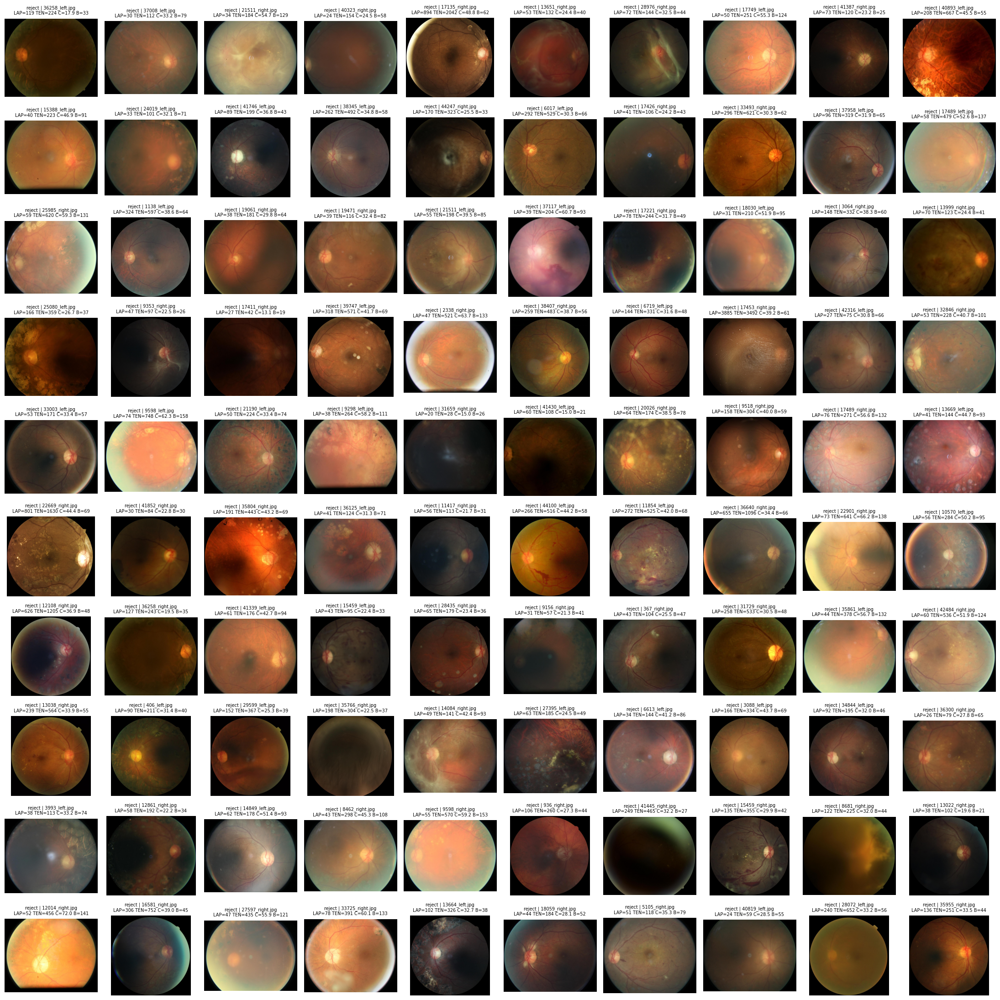


=== XEM NHANH: USABLE ===


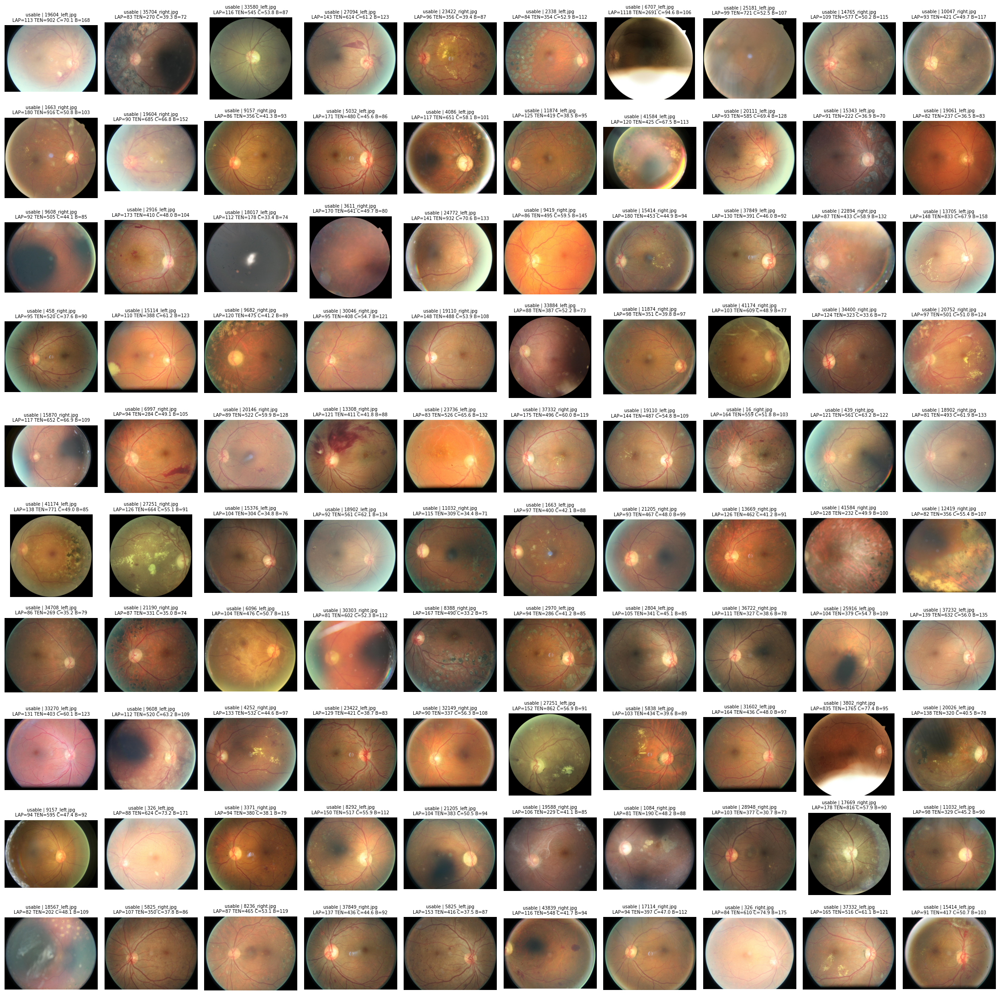


=== XEM NHANH: GOOD ===


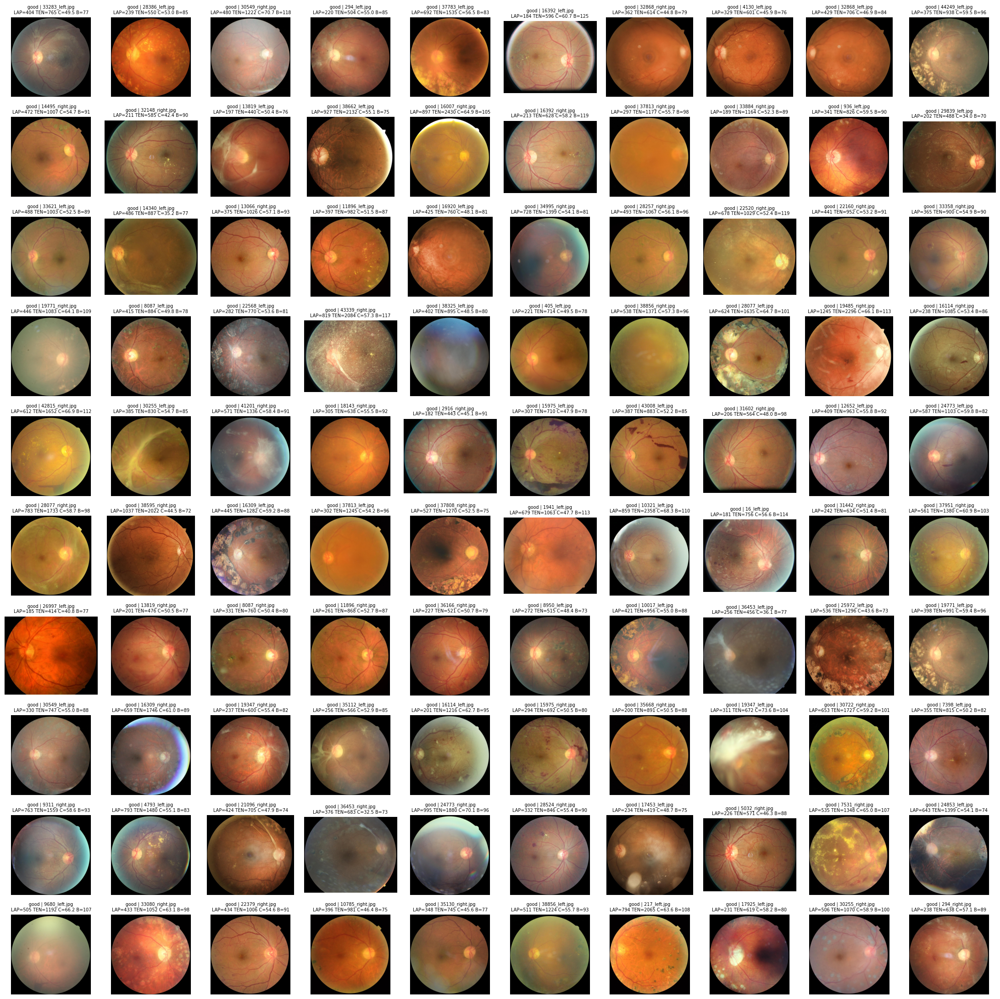


===== TỔNG HỢP CHẤT LƯỢNG =====
  quality  count
0  reject    449
1    good    156
2  usable    103


In [9]:
def print_summary(df):
    print("\n===== TỔNG QUAN METRIC =====")
    cols = ["lap_var","tenengrad","brightness","contrast","dark_frac","white_frac","foreground_ratio"]
    print(df[cols].describe(percentiles=[0.05,0.1,0.25,0.5,0.75,0.9,0.95]).round(2))
    print("\n===== PHÂN BỐ NHÃN CHẤT LƯỢNG =====")
    print(df["quality"].value_counts())

if __name__ == "__main__":
    paths = collect_paths_flat(ROOT_DIR, EXT)
    print(f"Found {len(paths)} images under {ROOT_DIR}.")
    if len(paths) == 0:
        raise SystemExit("Không tìm thấy ảnh. Kiểm tra ROOT_DIR / EXT.")

    df = score_and_label(paths)
    print_summary(df)
    df.to_csv(OUTPUT_CSV, index=False, encoding="utf-8-sig")
    print(f"Đã lưu nhãn chất lượng vào: {OUTPUT_CSV}")

    # Hiển thị mẫu ~100 ảnh mỗi nhãn (nếu đủ)
    for q in ["reject", "usable", "good"]:
        print(f"\n=== XEM NHANH: {q.upper()} ===")
        show_samples_for_quality(df, quality=q, n=PER_LABEL_SHOW, save_dir=SAVE_PREVIEW_DIR)

    # ====== Thống kê tổng quan chất lượng và lưu ra CSV ======
    quality_stats = df["quality"].value_counts().rename_axis("quality").reset_index(name="count")
    print("\n===== TỔNG HỢP CHẤT LƯỢNG =====")
    print(quality_stats)
    quality_stats.to_csv("quality_stats.csv", index=False, encoding="utf-8-sig")

In [12]:
METHOD = "ben_graham"              # "ben_graham" | "clahe_lab" | "clahe_green"
TARGET_SIZE = 600                  # ảnh đầu ra (h = w = 600)
APPLY_CIRCULAR_MASK = True         # che góc đen
DO_CROP_FOV = True                 # crop sát vùng võng mạc trước khi resize
MARGIN_CIRCLE = 4 
def crop_fov(img, thr=10):
    """Crop sát vùng võng mạc: xác định bbox của các pixel > thr (loại biên đen)."""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > thr
    if not np.any(mask):
        return img
    ys, xs = np.where(mask)
    y0, y1 = int(ys.min()), int(ys.max())
    x0, x1 = int(xs.min()), int(xs.max())
    # phòng hờ biên
    y0 = max(0, y0-2); x0 = max(0, x0-2)
    y1 = min(img.shape[0]-1, y1+2); x1 = min(img.shape[1]-1, x1+2)
    return img[y0:y1+1, x0:x1+1]

def apply_circular_mask(img, margin=MARGIN_CIRCLE):
    """Giữ vùng tròn trung tâm, che góc đen cho ảnh võng mạc."""
    h, w = img.shape[:2]
    r = min(h, w)//2 - margin
    if r <= 0:
        return img
    cx, cy = w//2, h//2
    mask = np.zeros((h, w), np.uint8)
    cv2.circle(mask, (cx, cy), r, 255, -1)
    out = cv2.bitwise_and(img, img, mask=mask)
    return out

def preprocess_ben_graham(bgr, sigma=10):
    """
    Ben Graham preprocessing: giảm non-uniform illumination.
    Công thức phổ biến: out = 4*img - 4*GaussianBlur(img, sigma) + 128
    """
    gb = cv2.GaussianBlur(bgr, (0, 0), sigmaX=sigma, sigmaY=sigma)
    out = cv2.addWeighted(bgr, 4.0, gb, -4.0, 128)
    return np.clip(out, 0, 255).astype(np.uint8)

def preprocess_clahe_lab(bgr, clip=2.0, tile=(8,8)):
    lab = cv2.cvtColor(bgr, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip, tileGridSize=tile)
    l2 = clahe.apply(l)
    lab2 = cv2.merge([l2, a, b])
    return cv2.cvtColor(lab2, cv2.COLOR_LAB2BGR)

def preprocess_clahe_green(bgr, clip=2.0, tile=(8,8)):
    g = bgr[:, :, 1]
    clahe = cv2.createCLAHE(clipLimit=clip, tileGridSize=tile)
    g2 = clahe.apply(g)
    # replicate sang 3 kênh để giữ đầu vào 3-channels cho backbone
    return cv2.merge([g2, g2, g2])

def resize_square(img, size=TARGET_SIZE):
    return cv2.resize(img, (size, size), interpolation=cv2.INTER_AREA)

def process_one(img_bgr):
    x = img_bgr.copy()
    # 1) Crop vùng FOV (loại viền đen, cắt gọn)
    if DO_CROP_FOV:
        x = crop_fov(x, thr=10)
    # 2) Resize tạm về vuông để mask tròn đẹp
    x = resize_square(x, TARGET_SIZE)
    # 3) Chọn 1 trong các phương pháp tiền xử lý
    if METHOD == "ben_graham":
        x = preprocess_ben_graham(x, sigma=10)
    elif METHOD == "clahe_lab":
        x = preprocess_clahe_lab(x, clip=2.0, tile=(8,8))
    elif METHOD == "clahe_green":
        x = preprocess_clahe_green(x, clip=2.0, tile=(8,8))
    else:
        # không chọn → giữ nguyên
        pass
    # 4) (tuỳ chọn) Circular mask để che góc
    if APPLY_CIRCULAR_MASK:
        x = apply_circular_mask(x, margin=MARGIN_CIRCLE)
    # 5) Đảm bảo kích thước đầu ra
    x = resize_square(x, TARGET_SIZE)
    return x

Scoring: 100%|██████████| 708/708 [00:10<00:00, 66.71it/s]


Số ảnh tối: 106


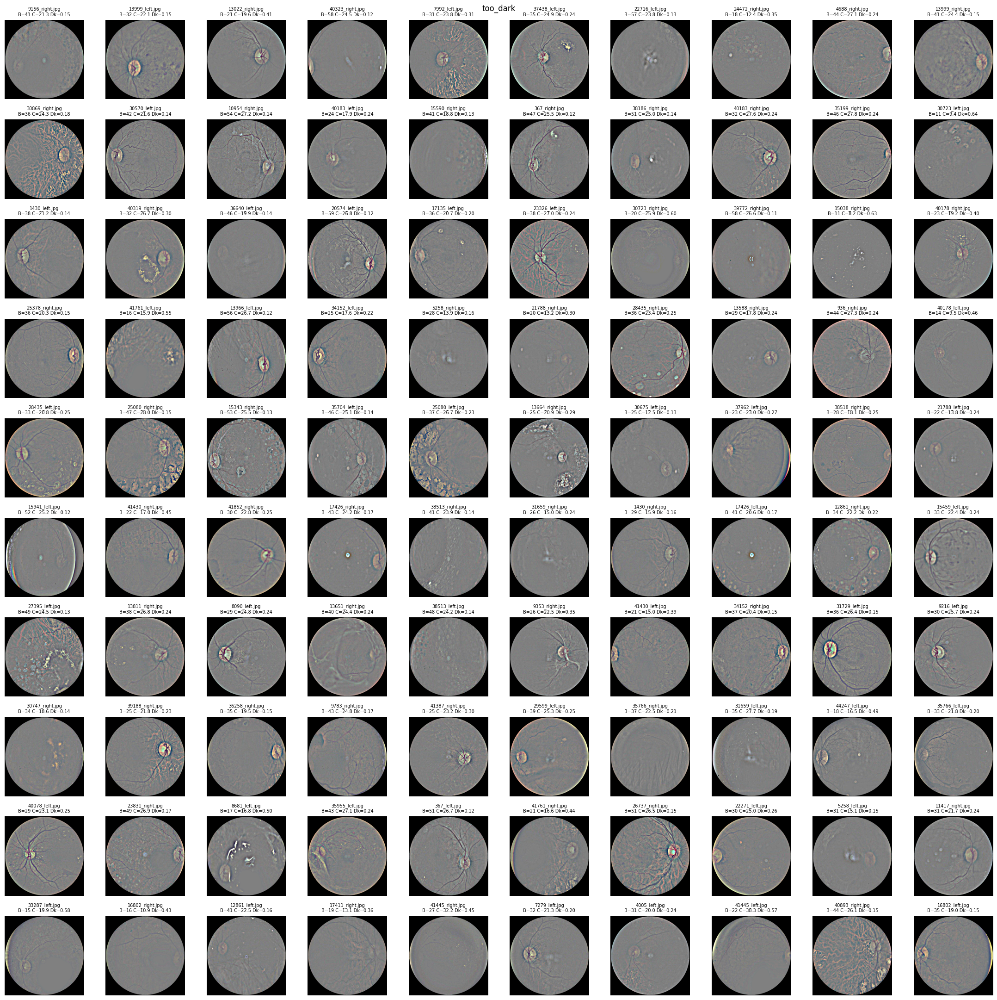

In [13]:
paths = collect_paths_flat(ROOT_DIR, EXT)
df = score_and_label(paths)

# 1) Định nghĩa điều kiện “tối không rõ”
MIN_BRIGHT   = 60.0   # tuỳ chỉnh
MAX_DARKFRAC = 0.45
MIN_CONTRAST = 28.0

mask_too_dark = (
    ((df["brightness"] < MIN_BRIGHT) & (df["contrast"] < MIN_CONTRAST)) |
    (df["dark_frac"] > MAX_DARKFRAC)
)

dark_df = df[mask_too_dark].copy()
print("Số ảnh tối:", len(dark_df))

# 2) Xem nhanh vài ảnh tối
def show_samples(df_sub, n=PER_LABEL_SHOW, title="too_dark"):
    if len(df_sub) == 0:
        print("[too_dark] Không có ảnh.")
        return
    k = min(n, len(df_sub))
    sample = df_sub.sample(k, random_state=42)
    cols = 10 if k >= 50 else 5
    rows = int(math.ceil(k / cols))
    plt.figure(figsize=(cols*2.2, rows*2.2))
    for i, (_, r) in enumerate(sample.iterrows()):
        img = imread_rgb(r["path"])
        if img is None: continue
        plt.subplot(rows, cols, i+1)
        plt.imshow(process_one(img)); plt.axis("off")
        t = f"{os.path.basename(r['path'])}\nB={r['brightness']:.0f} C={r['contrast']:.1f} Dk={r['dark_frac']:.2f}"
        plt.title(t, fontsize=7)
    plt.suptitle(title); plt.tight_layout(); plt.show()

show_samples(dark_df, n=PER_LABEL_SHOW, title="too_dark")

In [ ]:
# ========= Xóa ảnh 'reject' (tùy chọn: bỏ comment nếu muốn xóa) =============
# CSV_PATH = OUTPUT_CSV
# df_del = pd.read_csv(CSV_PATH)
# reject_paths = df_del[df_del['quality'].str.lower().eq('reject')]['path'].astype(str).tolist()
# print(f"Found {len(reject_paths)} reject files in CSV.")
# deleted = 0
# missing = 0
# errors = 0
# for p in reject_paths:
#     try:
#         if os.path.exists(p):
#             os.remove(p)
#             deleted += 1
#         else:
#             missing += 1
#     except Exception as e:
#         errors += 1
#         print(f"[LỖI] {p}: {e}")
# print(f"ĐÃ XÓA: {deleted}  |  KHÔNG TỒN TẠI: {missing}  |  LỖI: {errors}")

In [4]:
pd.read_csv( "image_quality_labels.csv")['quality'].value_counts()


quality
usable    14521
good      13402
reject     7185
Name: count, dtype: int64

In [ ]:
!ipynb-py-convert pre_preprocess_delete_reject_image.ipynb pre_preprocess_delete_reject_image.py